In [114]:
import numpy as np
import os
import tensorflow as tf
from tensorflow.data import Dataset
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from tensorflow.keras.layers import Input, LSTM, Dense, Bidirectional, Activation, GRU
from tensorflow.keras.models import Model
from tensorflow.keras import optimizers
from tensorflow.keras import losses
from tensorflow.keras import metrics
from tensorflow.keras.utils import plot_model, to_categorical
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import timeseries_dataset_from_array
from tensorflow.keras.callbacks import LambdaCallback
from sklearn import tree
from sklearn.metrics import confusion_matrix
import itertools
import time
import multiprocessing

%matplotlib inline

gpus = tf.config.experimental.list_physical_devices(device_type='GPU')
print(gpus)
tf.config.experimental.set_visible_devices(devices=gpus[0], device_type='GPU')
tf.config.experimental.set_memory_growth(device=gpus[0], enable=True)

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [109]:
pwd = os.getcwd()
all_file_names = []
scenarios = ['scenario'+str(i+1) for i in range(5)]
data_dist_table = pd.DataFrame(index=['Hold','Takeoff','Hover','Search','Loiter','Obstacleavoid','Land'])
for scenario in scenarios:
    count_dict = {'Hold':0,'Takeoff':0,'Hover':0,'Search':0,'Loiter':0,'Obstacleavoid':0,'Land':0}
    database_path = pwd[:-6] + "flightData/filtered_data/"+scenario
    database_file_names = []
    for root, dirs, files in os.walk(database_path):
        database_file_names = [os.path.join(root,file) for file in files]
    all_file_names += database_file_names
    for file in database_file_names:
        data = pd.read_csv(file)
        label_count = data['label'].value_counts()
        for indx in label_count.index:
            count_dict[indx] += label_count[indx]
    data_dist_table[scenario] = count_dict.values()
print(data_dist_table) 

               scenario1  scenario2  scenario3  scenario4  scenario5
Hold               13264       3378      64310      15361      33644
Takeoff             1813       1850       1900       1978       1974
Hover               9001       9036       9045       9039       9025
Search                 0      40868     204655     154459     156413
Loiter                 0          0      83451          0      49397
Obstacleavoid          0          0          0       7665       9119
Land                1940       1974       1986       1993       2027


In [115]:
scaler7 = MinMaxScaler()
encoder7 = OneHotEncoder()
scaler9 = MinMaxScaler()
encoder9 = OneHotEncoder()
pwd = os.getcwd()
database_path = pwd[:-6] + "flightData/filtered_data/scenario5"
database_file_names = []
for root, dirs, files in os.walk(database_path):
    database_file_names = [os.path.join(root,file) for file in files]

data = pd.read_csv(database_file_names[0])
X_train = data.drop(columns=['label', 'time','x','y','pitch_v','roll_v','yaw_v'])
X_train = X_train.values
Y_train = data['label'].values
Y_train = Y_train.reshape((-1,1))
_ = scaler7.fit_transform(X_train)
_ = encoder7.fit_transform(Y_train).toarray()

X_train = data.drop(columns=['label', 'time','pitch_v','roll_v','yaw_v'])
X_train = X_train.values
Y_train = data['label'].values
Y_train = Y_train.reshape((-1,1))
_ = scaler9.fit_transform(X_train)
_ = encoder9.fit_transform(Y_train).toarray()

In [47]:
%%time

# evaluation of models

# deep LSTM model
time_steps = [32, 64, 128]
num_features = [7,9]
num_class = 7
direction = 2
neuron_sizes = [64, 128, 256, 512]
lstm_layers = 1
pwd = os.getcwd()
model_path = pwd+'/models/'


model_wise_acc = {}
itit = 0
for time_step in time_steps:
    for num_feature in num_features:
        for neuron_size in neuron_sizes:
            for model_no in range(1,71):
                # load model
                model_name = 'lstm_direction_' + str(direction)\
                             + '_layers_' + str(lstm_layers)\
                             + '_features_' + str(num_feature)\
                             + '_neurons_' + str(neuron_size)\
                             + '_timesteps_' + str(time_step)\
                             + '_epochs_' + str((model_no)*10) + '.h5'
                if os.path.isfile(model_path+model_name):
                    model = load_model(model_path+model_name)

                    acc_by_scenario = {'scenario'+str(i+1):[[],[]] for i in range(5)}
                    prev_key = None
                    x_values = []
                    y_values = []

                    for i,file in enumerate(all_file_names):
                        data = pd.read_csv(file)
                        if num_feature == 7:
                            X_test = data.drop(columns=['label', 'time','x','y','pitch_v','roll_v','yaw_v'])
                            X_test = X_test.values
                            Y_test = data['label'].values
                            Y_test = Y_test.reshape((-1,1))

                            X_test = scaler7.transform(X_test)
                            Y_test = encoder7.transform(Y_test).toarray()
                        else:
                            X_test = data.drop(columns=['label', 'time','pitch_v','roll_v','yaw_v'])
                            X_test = X_test.values
                            Y_test = data['label'].values
                            Y_test = Y_test.reshape((-1,1))

                            X_test = scaler9.transform(X_test)
                            Y_test = encoder9.transform(Y_test).toarray()
                        

                        input_data = X_test[:-time_step,:]
                        targets = Y_test[time_step:,:]
                        dataset = timeseries_dataset_from_array(input_data, 
                                                                targets, 
                                                                sequence_length=time_step,
                                                                batch_size=128)
                        hist = model.evaluate(dataset,
                                              verbose=1,
                                              callbacks=None,#[batch_print_callback],
                                              max_queue_size=512,
                                              workers=80,
                                              use_multiprocessing=True,
                                              return_dict=True)

                        key = file.split('/')[-2]
                        acc_by_scenario[key][0].append(int(((file.split('/')[-1]).split('_')[-1]).split('.')[0]))
                        acc_by_scenario[key][1].append(hist['categorical_accuracy'])
                    model_wise_acc[model_name] = {key:np.max(acc_by_scenario[key][1]) for key in acc_by_scenario.keys()}
                    print(model_wise_acc)
                else:
                    print('No model found: '+model_name)
                    itit += 1
                
print(itit)

435/435 [==============================] - 4s 10ms/step - loss: 1.7372 - categorical_accuracy: 0.7093
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}}
435/435 [==============================] - 4s 9ms/step - loss: 1.7434 - categorical_accuracy: 0.7098
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}}
435/435 [==============================] - 4s 10ms/step - loss: 1.

435/435 [==============================] - 4s 9ms/step - loss: 0.9622 - categorical_accuracy: 0.7944
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.5563 - categorical_accuracy: 0.7235
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.9900 - categorical_accuracy: 0.7780
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.5992 - categorical_accuracy: 0.8027
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 0.7044 - categorical_accuracy: 0.7839
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 0.6867 - categorical_accuracy: 0.7276
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 0.4257 - categorical_accuracy: 0.8349
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.4996 - categorical_accuracy: 0.8081
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.8504 - categorical_accuracy: 0.7634
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 0.6583 - categorical_accuracy: 0.7701
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 0.6355 - categorical_accuracy: 0.7475
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.6057 - categorical_accuracy: 0.7910
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.2251 - categorical_accuracy: 0.7633
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 0.7898 - categorical_accuracy: 0.7324
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 0.8395 - categorical_accuracy: 0.7701
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.1416 - categorical_accuracy: 0.7803
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.8433 - categorical_accuracy: 0.7940
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.8840 - categorical_accuracy: 0.8153
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.0983 - categorical_accuracy: 0.7807
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.1304 - categorical_accuracy: 0.7792
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.0598 - categorical_accuracy: 0.7782
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.0098 - categorical_accuracy: 0.7697
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.2224 - categorical_accuracy: 0.7209
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.2531 - categorical_accuracy: 0.7708
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.2247 - categorical_accuracy: 0.7602
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 2.5747 - categorical_accuracy: 0.7624
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 2.7553 - categorical_accuracy: 0.7385
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 2.5025 - categorical_accuracy: 0.7716
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.4469 - categorical_accuracy: 0.7869
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.7460 - categorical_accuracy: 0.7948
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 2.3703 - categorical_accuracy: 0.5963
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 2.2399 - categorical_accuracy: 0.7647
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 5s 10ms/step - loss: 1.2669 - categorical_accuracy: 0.7660
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.1029 - categorical_accuracy: 0.7830
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.2749 - categorical_accuracy: 0.7891
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.2838 - categorical_accuracy: 0.7812
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.2207 - categorical_accuracy: 0.7972
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.5004 - categorical_accuracy: 0.7846
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.0912 - categorical_accuracy: 0.7348
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.0529 - categorical_accuracy: 0.7547
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.0084 - categorical_accuracy: 0.7683
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.3098 - categorical_accuracy: 0.7604
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.1450 - categorical_accuracy: 0.7862
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.8711 - categorical_accuracy: 0.7699
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.0295 - categorical_accuracy: 0.6527
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.9983 - categorical_accuracy: 0.7702
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 2.0203 - categorical_accuracy: 0.4764
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.9393 - categorical_accuracy: 0.7842
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.2864 - categorical_accuracy: 0.7171
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.1040 - categorical_accuracy: 0.7754
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.3938 - categorical_accuracy: 0.7595
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.0739 - categorical_accuracy: 0.7909
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 0.9128 - categorical_accuracy: 0.8049
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.3309 - categorical_accuracy: 0.7574
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.9286 - categorical_accuracy: 0.7093
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.5780 - categorical_accuracy: 0.7093
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.2103 - categorical_accuracy: 0.7663
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.2757 - categorical_accuracy: 0.7182
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.0154 - categorical_accuracy: 0.7832
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.9348 - categorical_accuracy: 0.7166
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.0859 - categorical_accuracy: 0.7630
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.9013 - categorical_accuracy: 0.7906
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.1110 - categorical_accuracy: 0.7733
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.0128 - categorical_accuracy: 0.7627
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.4282 - categorical_accuracy: 0.7763
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 0.8853 - categorical_accuracy: 0.7817
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.1246 - categorical_accuracy: 0.7688
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 10ms/step - loss: 1.4958 - categorical_accuracy: 0.7319
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.9247 - categorical_accuracy: 0.7952
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.9558 - categorical_accuracy: 0.7894
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.7074 - categorical_accuracy: 0.7411
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.7285 - categorical_accuracy: 0.7014
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.6456 - categorical_accuracy: 0.7510
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.8147 - categorical_accuracy: 0.7552
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 2.2873 - categorical_accuracy: 0.7344
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.8229 - categorical_accuracy: 0.7433
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.0124 - categorical_accuracy: 0.6734
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.7940 - categorical_accuracy: 0.8051
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.9751 - categorical_accuracy: 0.7439
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.2294 - categorical_accuracy: 0.7031
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.6718 - categorical_accuracy: 0.7890
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.5715 - categorical_accuracy: 0.8283
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 3.0922 - categorical_accuracy: 0.7127
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 10ms/step - loss: 3.1371 - categorical_accuracy: 0.6689
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.2470 - categorical_accuracy: 0.7816
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.0868 - categorical_accuracy: 0.7476
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.0432 - categorical_accuracy: 0.7721
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.1394 - categorical_accuracy: 0.7678
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.3880 - categorical_accuracy: 0.7391
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.1252 - categorical_accuracy: 0.7258
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 5s 10ms/step - loss: 1.2645 - categorical_accuracy: 0.7798
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.0888 - categorical_accuracy: 0.7909
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.0876 - categorical_accuracy: 0.7898
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 0.9848 - categorical_accuracy: 0.7688
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.8741 - categorical_accuracy: 0.8014
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.3048 - categorical_accuracy: 0.7512
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.0498 - categorical_accuracy: 0.7948
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 3.9944 - categorical_accuracy: 0.7134
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.4882 - categorical_accuracy: 0.7794
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.4063 - categorical_accuracy: 0.7744
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 2.9517 - categorical_accuracy: 0.7050
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.4586 - categorical_accuracy: 0.7825
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.7406 - categorical_accuracy: 0.7736
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.9180 - categorical_accuracy: 0.7669
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.7604 - categorical_accuracy: 0.7137
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 2.1411 - categorical_accuracy: 0.7170
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 3.7901 - categorical_accuracy: 0.7106
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.8592 - categorical_accuracy: 0.7337
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.9647 - categorical_accuracy: 0.7529
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 2.0757 - categorical_accuracy: 0.7137
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 2.0559 - categorical_accuracy: 0.7501
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 2.0285 - categorical_accuracy: 0.7527
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 2.0159 - categorical_accuracy: 0.7686
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.8035 - categorical_accuracy: 0.7525
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 2.1341 - categorical_accuracy: 0.7241
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 2.0587 - categorical_accuracy: 0.7463
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.6285 - categorical_accuracy: 0.7659
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.9425 - categorical_accuracy: 0.7654
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.6115 - categorical_accuracy: 0.7712
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.7031 - categorical_accuracy: 0.7595
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.6109 - categorical_accuracy: 0.7772
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.5342 - categorical_accuracy: 0.7763
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.5647 - categorical_accuracy: 0.7700
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 2.5675 - categorical_accuracy: 0.7257
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.3304 - categorical_accuracy: 0.7087
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 2.1427 - categorical_accuracy: 0.7114
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 2.3725 - categorical_accuracy: 0.7107
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 2.2064 - categorical_accuracy: 0.7525
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.4053 - categorical_accuracy: 0.5268
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.0949 - categorical_accuracy: 0.7786
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.0080 - categorical_accuracy: 0.7868
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.5559 - categorical_accuracy: 0.7173
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.2125 - categorical_accuracy: 0.7734
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.0417 - categorical_accuracy: 0.7761
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 2.0599 - categorical_accuracy: 0.7152
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.1021 - categorical_accuracy: 0.7604
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.9209 - categorical_accuracy: 0.7885
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.6638 - categorical_accuracy: 0.4764
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.9621 - categorical_accuracy: 0.7495
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.0662 - categorical_accuracy: 0.7421
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 5s 10ms/step - loss: 1.1979 - categorical_accuracy: 0.8046
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.8353 - categorical_accuracy: 0.8289
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.7949 - categorical_accuracy: 0.8223
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.1338 - categorical_accuracy: 0.6591
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 0.5881 - categorical_accuracy: 0.8226
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 0.9609 - categorical_accuracy: 0.7168
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.8922 - categorical_accuracy: 0.7360
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.1573 - categorical_accuracy: 0.7117
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 0.7369 - categorical_accuracy: 0.8011
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 0.7250 - categorical_accuracy: 0.8042
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.0152 - categorical_accuracy: 0.7938
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.7321 - categorical_accuracy: 0.7114
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.9438 - categorical_accuracy: 0.6851
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.6471 - categorical_accuracy: 0.5694
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 0.8158 - categorical_accuracy: 0.8099
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.2588 - categorical_accuracy: 0.5426
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.6526 - categorical_accuracy: 0.8263
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.3194 - categorical_accuracy: 0.7044
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.9794 - categorical_accuracy: 0.7391
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.1646 - categorical_accuracy: 0.7339
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 1.0277 - categorical_accuracy: 0.7841
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 0.8068 - categorical_accuracy: 0.8047
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.9484 - categorical_accuracy: 0.8196
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.7631 - categorical_accuracy: 0.7984
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.3009 - categorical_accuracy: 0.7940
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 0.8290 - categorical_accuracy: 0.7832
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.9430 - categorical_accuracy: 0.7636
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.8608 - categorical_accuracy: 0.8373
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 3.1688 - categorical_accuracy: 0.8069
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.3300 - categorical_accuracy: 0.6267
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 1.1639 - categorical_accuracy: 0.7712
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.2723 - categorical_accuracy: 0.7226
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 1.0596 - categorical_accuracy: 0.8102
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.9386 - categorical_accuracy: 0.7327
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 1.8535 - categorical_accuracy: 0.7931
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 0.8654 - categorical_accuracy: 0.7917
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 0.7568 - categorical_accuracy: 0.8095
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 2.6945 - categorical_accuracy: 0.7443
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 2.4180 - categorical_accuracy: 0.7484
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 7.9198 - categorical_accuracy: 0.7120
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 6.8324 - categorical_accuracy: 0.7231
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 5.1467 - categorical_accuracy: 0.6983
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 5s 10ms/step - loss: 3.2593 - categorical_accuracy: 0.7444
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 2.9978 - categorical_accuracy: 0.7201
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 3.2161 - categorical_accuracy: 0.7285
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 6.5864 - categorical_accuracy: 0.5893
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 5.2417 - categorical_accuracy: 0.4409
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 9ms/step - loss: 7.8487 - categorical_accuracy: 0.6836
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 2.0011 - categorical_accuracy: 0.7420
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 3.7617 - categorical_accuracy: 0.7630
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 9ms/step - loss: 3.0140 - categorical_accuracy: 0.7225
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.8216027617

435/435 [==============================] - 4s 10ms/step - loss: 13.7310 - categorical_accuracy: 0.7291
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.82160276

435/435 [==============================] - 4s 10ms/step - loss: 9.9868 - categorical_accuracy: 0.6677
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 4s 10ms/step - loss: 3.9903 - categorical_accuracy: 0.7527
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.5114 - categorical_accuracy: 0.5186
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.3624 - categorical_accuracy: 0.7093
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.5621 - categorical_accuracy: 0.6834
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.2217 - categorical_accuracy: 0.7093
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.3580 - categorical_accuracy: 0.7112
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.6844 - categorical_accuracy: 0.7158
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.1946 - categorical_accuracy: 0.4451
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.5372 - categorical_accuracy: 0.7068
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.3863 - categorical_accuracy: 0.7182
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.4448 - categorical_accuracy: 0.7170
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.1453 - categorical_accuracy: 0.7810
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 12ms/step - loss: 1.2836 - categorical_accuracy: 0.7592
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.3089 - categorical_accuracy: 0.7223
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.1770 - categorical_accuracy: 0.7425
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 0.9758 - categorical_accuracy: 0.7909
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.0146 - categorical_accuracy: 0.7772
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.3848 - categorical_accuracy: 0.7841
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.5845 - categorical_accuracy: 0.7857
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 0.7211 - categorical_accuracy: 0.7878
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 12ms/step - loss: 0.9105 - categorical_accuracy: 0.7732
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.1137 - categorical_accuracy: 0.7496
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.2585 - categorical_accuracy: 0.7277
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 0.8568 - categorical_accuracy: 0.8020
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 12ms/step - loss: 2.7025 - categorical_accuracy: 0.7182
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.5551 - categorical_accuracy: 0.7563
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.1462 - categorical_accuracy: 0.7778
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.6768 - categorical_accuracy: 0.7505
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.0646 - categorical_accuracy: 0.7924
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.7467 - categorical_accuracy: 0.7633
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 12ms/step - loss: 1.4830 - categorical_accuracy: 0.6907
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.4732 - categorical_accuracy: 0.7555
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.9296 - categorical_accuracy: 0.6795
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.4886 - categorical_accuracy: 0.7760
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.4915 - categorical_accuracy: 0.7726
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.8528 - categorical_accuracy: 0.7741
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.1979 - categorical_accuracy: 0.7144
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.4834 - categorical_accuracy: 0.7437
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 3.6061 - categorical_accuracy: 0.7247
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.9541 - categorical_accuracy: 0.6776
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.2495 - categorical_accuracy: 0.7747
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 3.3625 - categorical_accuracy: 0.7200
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 3.4585 - categorical_accuracy: 0.7536
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.7697 - categorical_accuracy: 0.7271
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.9733 - categorical_accuracy: 0.7361
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.0077 - categorical_accuracy: 0.7794
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.4259 - categorical_accuracy: 0.7391
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 1.8567 - categorical_accuracy: 0.7639
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.6600 - categorical_accuracy: 0.7625
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.1715 - categorical_accuracy: 0.7366
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.6474 - categorical_accuracy: 0.7698
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.6475 - categorical_accuracy: 0.7455
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.2182 - categorical_accuracy: 0.7709
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 3.2776 - categorical_accuracy: 0.7126
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 3.1636 - categorical_accuracy: 0.7132
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 3.5082 - categorical_accuracy: 0.7599
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 3.4972 - categorical_accuracy: 0.7332
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 3.1281 - categorical_accuracy: 0.7563
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.8554 - categorical_accuracy: 0.7547
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.8771 - categorical_accuracy: 0.7606
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.9211 - categorical_accuracy: 0.7659
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.6573 - categorical_accuracy: 0.7767
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.6100 - categorical_accuracy: 0.7525
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.6622 - categorical_accuracy: 0.7837
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 4.9422 - categorical_accuracy: 0.7428
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 3.2424 - categorical_accuracy: 0.7856
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 4.1780 - categorical_accuracy: 0.7741
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.3887 - categorical_accuracy: 0.8096
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 2.4851 - categorical_accuracy: 0.8017
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 3.9634 - categorical_accuracy: 0.7459
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

435/435 [==============================] - 5s 11ms/step - loss: 3.0446 - categorical_accuracy: 0.7559
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 1.1979 - categorical_accuracy: 0.7133
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.9041 - categorical_accuracy: 0.7542
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6679 - categorical_accuracy: 0.7750
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6139 - categorical_accuracy: 0.8016
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6650 - categorical_accuracy: 0.7820
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5809 - categorical_accuracy: 0.7876
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5380 - categorical_accuracy: 0.7946
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.4428 - categorical_accuracy: 0.8450
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.4381 - categorical_accuracy: 0.8340
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.4626 - categorical_accuracy: 0.8283
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5085 - categorical_accuracy: 0.8127
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5410 - categorical_accuracy: 0.8327
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.3361 - categorical_accuracy: 0.8668
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 15ms/step - loss: 0.3572 - categorical_accuracy: 0.8785
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.3762 - categorical_accuracy: 0.8754
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 13ms/step - loss: 0.2802 - categorical_accuracy: 0.9027
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.2605 - categorical_accuracy: 0.9061
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5079 - categorical_accuracy: 0.8356
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.2357 - categorical_accuracy: 0.9281
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.2112 - categorical_accuracy: 0.9311
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.1917 - categorical_accuracy: 0.9368
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.2078 - categorical_accuracy: 0.9278
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.3639 - categorical_accuracy: 0.8741
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.2713 - categorical_accuracy: 0.9117
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.3106 - categorical_accuracy: 0.8985
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.2439 - categorical_accuracy: 0.9189
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.1602 - categorical_accuracy: 0.9464
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.1893 - categorical_accuracy: 0.9363
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.1559 - categorical_accuracy: 0.9466
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 13ms/step - loss: 0.1939 - categorical_accuracy: 0.9293
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.1889 - categorical_accuracy: 0.9420
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.3293 - categorical_accuracy: 0.9084
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.4822 - categorical_accuracy: 0.8374
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5194 - categorical_accuracy: 0.8585
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5315 - categorical_accuracy: 0.8356
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 15ms/step - loss: 0.4071 - categorical_accuracy: 0.8638
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.2529 - categorical_accuracy: 0.9106
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.1976 - categorical_accuracy: 0.9309
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 13ms/step - loss: 0.2185 - categorical_accuracy: 0.9217
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.2454 - categorical_accuracy: 0.9134
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.2260 - categorical_accuracy: 0.9194
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.2592 - categorical_accuracy: 0.9068
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 15ms/step - loss: 0.2663 - categorical_accuracy: 0.9141
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.2927 - categorical_accuracy: 0.9042
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.2184 - categorical_accuracy: 0.9217
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.2046 - categorical_accuracy: 0.9288
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.3697 - categorical_accuracy: 0.8879
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.3389 - categorical_accuracy: 0.8910
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.9398 - categorical_accuracy: 0.8361
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.3465 - categorical_accuracy: 0.8828
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 15ms/step - loss: 0.2784 - categorical_accuracy: 0.9021
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.2307 - categorical_accuracy: 0.9151
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6014 - categorical_accuracy: 0.8307
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 1.8193 - categorical_accuracy: 0.7345
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.9485 - categorical_accuracy: 0.7641
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.7281 - categorical_accuracy: 0.7988
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 13ms/step - loss: 0.5427 - categorical_accuracy: 0.8372
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.9966 - categorical_accuracy: 0.7509
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5597 - categorical_accuracy: 0.8320
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.7739 - categorical_accuracy: 0.8095
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.4290 - categorical_accuracy: 0.8687
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.3592 - categorical_accuracy: 0.8691
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.3442 - categorical_accuracy: 0.8729
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 2.4624 - categorical_accuracy: 0.7990
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5221 - categorical_accuracy: 0.8569
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.4939 - categorical_accuracy: 0.8274
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 15ms/step - loss: 0.6520 - categorical_accuracy: 0.8013
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 4.3043 - categorical_accuracy: 0.7451
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 15ms/step - loss: 1.1226 - categorical_accuracy: 0.7783
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 1.5350 - categorical_accuracy: 0.7359
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 1.3323 - categorical_accuracy: 0.7099
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.9107 - categorical_accuracy: 0.7161
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 1.1609 - categorical_accuracy: 0.7210
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.8497 - categorical_accuracy: 0.7714
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6659 - categorical_accuracy: 0.7901
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5707 - categorical_accuracy: 0.8120
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.4419 - categorical_accuracy: 0.8279
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5651 - categorical_accuracy: 0.8105
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5485 - categorical_accuracy: 0.8036
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 15ms/step - loss: 0.6311 - categorical_accuracy: 0.8036
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6864 - categorical_accuracy: 0.8120
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.3921 - categorical_accuracy: 0.8874
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 1.0548 - categorical_accuracy: 0.7421
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.9257 - categorical_accuracy: 0.7802
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.7298 - categorical_accuracy: 0.8303
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6365 - categorical_accuracy: 0.8294
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.4005 - categorical_accuracy: 0.8880
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5895 - categorical_accuracy: 0.8150
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5719 - categorical_accuracy: 0.8027
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.7392 - categorical_accuracy: 0.7822
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 1.0308 - categorical_accuracy: 0.7508
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 15ms/step - loss: 0.9361 - categorical_accuracy: 0.7589
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 1.1270 - categorical_accuracy: 0.7371
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6110 - categorical_accuracy: 0.8195
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5826 - categorical_accuracy: 0.8145
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 1.1408 - categorical_accuracy: 0.7577
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 1.1390 - categorical_accuracy: 0.7406
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.9073 - categorical_accuracy: 0.7804
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.9992 - categorical_accuracy: 0.7902
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 15ms/step - loss: 1.9191 - categorical_accuracy: 0.7790
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 15ms/step - loss: 0.5445 - categorical_accuracy: 0.8211
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.4259 - categorical_accuracy: 0.8543
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6254 - categorical_accuracy: 0.7866
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5905 - categorical_accuracy: 0.8497
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 15ms/step - loss: 0.9321 - categorical_accuracy: 0.7979
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 15ms/step - loss: 1.4933 - categorical_accuracy: 0.7192
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.8682 - categorical_accuracy: 0.7685
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.8340 - categorical_accuracy: 0.7757
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.8341 - categorical_accuracy: 0.8085
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.9750 - categorical_accuracy: 0.7685
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.7992 - categorical_accuracy: 0.8156
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6867 - categorical_accuracy: 0.8185
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6380 - categorical_accuracy: 0.8028
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.8361 - categorical_accuracy: 0.7961
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 15ms/step - loss: 0.6780 - categorical_accuracy: 0.8335
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.7024 - categorical_accuracy: 0.8187
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6379 - categorical_accuracy: 0.8221
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.8544 - categorical_accuracy: 0.8078
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.8054 - categorical_accuracy: 0.8037
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 1.9130 - categorical_accuracy: 0.7391
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.9229 - categorical_accuracy: 0.8042
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 15ms/step - loss: 0.6593 - categorical_accuracy: 0.8397
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.5824 - categorical_accuracy: 0.8431
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.7070 - categorical_accuracy: 0.8369
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.8021 - categorical_accuracy: 0.8132
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 13ms/step - loss: 0.9722 - categorical_accuracy: 0.8239
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6198 - categorical_accuracy: 0.8384
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6562 - categorical_accuracy: 0.8259
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6290 - categorical_accuracy: 0.8534
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.6146 - categorical_accuracy: 0.8412
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.4574 - categorical_accuracy: 0.8769
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 1.3516 - categorical_accuracy: 0.7515
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 10.4941 - categorical_accuracy: 0.7524
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.82160276

434/434 [==============================] - 6s 14ms/step - loss: 3.8778 - categorical_accuracy: 0.7033
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 1.2503 - categorical_accuracy: 0.7639
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.9385 - categorical_accuracy: 0.8004
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 1.2722 - categorical_accuracy: 0.7785
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 15ms/step - loss: 0.8663 - categorical_accuracy: 0.8077
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.7484 - categorical_accuracy: 0.8326
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

434/434 [==============================] - 6s 14ms/step - loss: 0.8023 - categorical_accuracy: 0.8422
{'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_10.h5': {'scenario1': 0.5660150647163391, 'scenario2': 0.9051950573921204, 'scenario3': 0.7882789373397827, 'scenario4': 0.9707176685333252, 'scenario5': 0.8689848184585571}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_20.h5': {'scenario1': 0.570644736289978, 'scenario2': 0.9090682864189148, 'scenario3': 0.788663923740387, 'scenario4': 0.970894992351532, 'scenario5': 0.8692010045051575}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_30.h5': {'scenario1': 0.6284293532371521, 'scenario2': 0.9205813407897949, 'scenario3': 0.7934978008270264, 'scenario4': 0.9729856848716736, 'scenario5': 0.8719329833984375}, 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_64_epochs_40.h5': {'scenario1': 0.6316872239112854, 'scenario2': 0.9024234414100647, 'scenario3': 0.821602761

No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_150.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_160.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_170.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_180.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_190.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_200.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_210.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_220.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_230.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_240.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_times

In [60]:
mx = 0
best_key = None
scenario_name = 'scenario1'
for key in model_wise_acc.keys():
    if model_wise_acc[key][scenario_name] > mx:
        mx = model_wise_acc[key][scenario_name]
        best_key = key
        
print(scenario_name, best_key, mx)
    

scenario1 lstm_direction_2_layers_1_features_7_neurons_64_timesteps_128_epochs_190.h5 0.9817714691162109


In [54]:
model_wise_acc['lstm_direction_2_layers_1_features_7_neurons_128_timesteps_128_epochs_700.h5']

{'scenario1': 0.9600852727890015,
 'scenario2': 0.7848218679428101,
 'scenario3': 0.8833605051040649,
 'scenario4': 0.9415426850318909,
 'scenario5': 0.87005215883255}

{'h': {'scenario1': 0.5707259178161621,
  'scenario2': 0.9084237217903137,
  'scenario3': 0.7884719371795654,
  'scenario4': 0.9707291722297668,
  'scenario5': 0.869057297706604}}

In [36]:
len(model_wise_acc.keys())

280

In [18]:
%%time

pwd = os.getcwd()
database_path = pwd[:-6] + "flightData/filtered_data/scenario2"
database_file_names = []
for root, dirs, files in os.walk(database_path):
    database_file_names = [os.path.join(root,file) for file in files]
    
files = ['/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario1/scenario1_5.csv',
         '/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario2/scenario2_8.csv',
         '/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario3/scenario3_10.csv',
         '/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario4/scenario4_8.csv',
         '/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario5/scenario5_4.csv']
#     ]

time_step = 128
model_path = pwd+'/models/'
model_name = 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_128_epochs_290.h5'#'lstm_model_blstm_' + str(50*10) + '.h5'
model = load_model(model_path+model_name)

data_plot = []
for i,file in enumerate(files):
    x_val = []
    y_val = []
    for multiplier in np.arange(0,1.7,.1):
        data = pd.read_csv(file)
        X_test = data.drop(columns=['label', 'time','x','y','pitch_v','roll_v','yaw_v'])
    #         print(X_test.describe())
        X_test = X_test.values
        stds = np.std(X_test,axis=0)
        means = np.mean(X_test,axis=0)
        noise = np.array([np.random.normal(0,multiplier*std,X_test.shape[0]) for mu,std in zip(means,stds)]).T
        X_test_noisy = X_test + noise
#         print(X_test.shape,noise.shape)
#         plt.plot(X_test[10000:10100,1],label='data')
#         plt.plot(noise[10000:10100,1],label='noise')
#         print(stds)
#         print(np.std(X_test_noisy,axis=0))

#         plt.legend()

        Y_test = data['label'].values
        Y_test = Y_test.reshape((-1,1))

        X_test = scaler7.transform(X_test_noisy)
        Y_test = encoder7.transform(Y_test).toarray()

        input_data = X_test[:-time_step,:]
        targets = Y_test[time_step:,:]
        dataset = timeseries_dataset_from_array(input_data, 
                                                targets, 
                                                sequence_length=time_step,
                                                batch_size=128)
        print(file)
        hist = model.evaluate(dataset,
                              verbose=1,
                              callbacks=None,#[batch_print_callback],
                              max_queue_size=512,
                              workers=80,
                              use_multiprocessing=True,
                              return_dict=True)
        x_val.append(multiplier)
        y_val.append(hist['categorical_accuracy'])
#         y_pred = model.predict(dataset,
#                               verbose=1,
#                               callbacks=None,#[batch_print_callback],
#                               max_queue_size=512,
#                               workers=80,
#                               use_multiprocessing=True)
        
#         y_pred = encoder7.inverse_transform(y_pred)
#         y_true = encoder7.inverse_transform(targets[0:y_pred.shape[0],:])
#         print(accuracy_score(y_true,y_pred))
#         print(classification_report(y_true,y_pred))
#         print(confusion_matrix(y_true,y_pred))
        
#         if i==0:
#             break
    data_plot.append([x_val,y_val])
                


/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario1/scenario1_5.csv
45/45 [==============================] - 2s 34ms/step - loss: 0.1102 - categorical_accuracy: 0.9707
/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario1/scenario1_5.csv
45/45 [==============================] - 1s 15ms/step - loss: 0.1099 - categorical_accuracy: 0.9700
/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario1/scenario1_5.csv
45/45 [==============================] - 1s 15ms/step - loss: 0.1252 - categorical_accuracy: 0.9681
/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario1/scenario1_5.csv
45/45 [==============================] - 1s 15ms/step - loss: 0.1641 - categorical_accuracy: 0.9588


64/64 [==============================] - 1s 15ms/step - loss: 2.8999 - categorical_accuracy: 0.6179
/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario2/scenario2_8.csv
64/64 [==============================] - 1s 14ms/step - loss: 2.8386 - categorical_accuracy: 0.6207
/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario3/scenario3_10.csv
547/547 [==============================] - 7s 14ms/step - loss: 0.1696 - categorical_accuracy: 0.9641
/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario3/scenario3_10.csv
547/547 [==============================] - 7s 14ms/step - loss: 0.1713 - categorical_accuracy: 0.9632
/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario3/scenario3_

451/451 [==============================] - 6s 14ms/step - loss: 2.7251 - categorical_accuracy: 0.5381
/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario4/scenario4_8.csv
451/451 [==============================] - 6s 14ms/step - loss: 3.1962 - categorical_accuracy: 0.4892
/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario4/scenario4_8.csv
451/451 [==============================] - 6s 14ms/step - loss: 3.7024 - categorical_accuracy: 0.4493
/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario5/scenario5_4.csv
466/466 [==============================] - 6s 14ms/step - loss: 0.1279 - categorical_accuracy: 0.9588
/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario5/scenario

In [25]:
data = np.array([np.random.normal(0,.009,100) for i in range(10)])
data.shape

(10, 100)

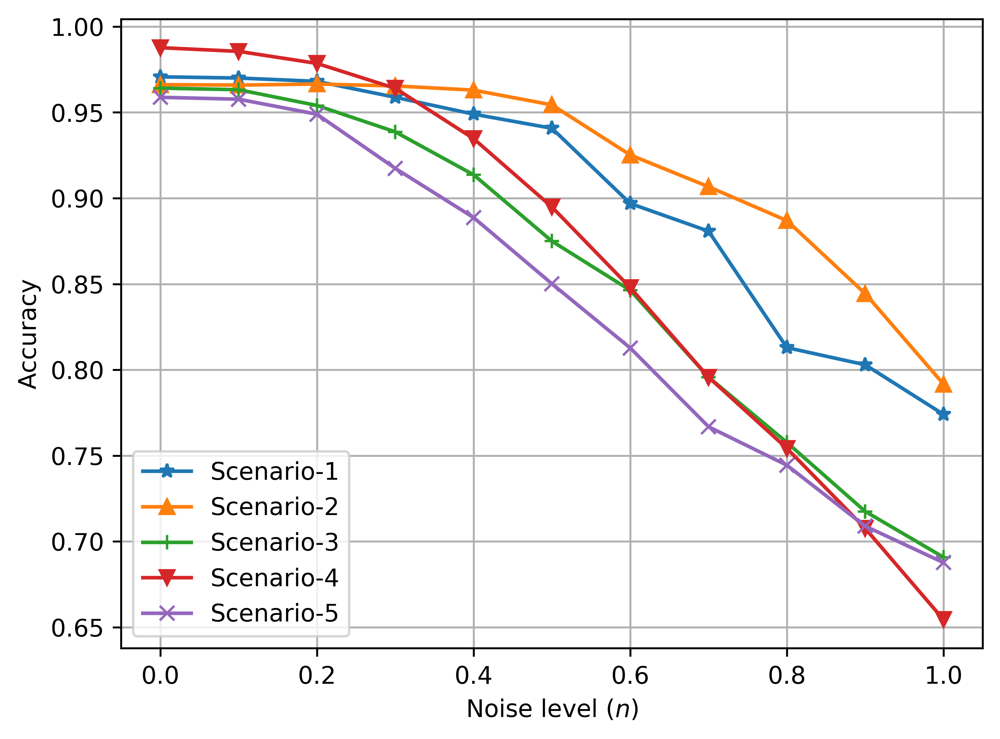

In [113]:
plt.figure(figsize=[6.4, 4.8],dpi=600)
markars = ['*','^','+','v','x']
for i,plt_data in enumerate(data_plot):
    plt.plot(plt_data[0][0:11],plt_data[1][0:11], marker=markars[i], label='Scenario-'+str(i+1))
plt.xlabel('Noise level ($n$)')
plt.ylabel('Accuracy')
plt.grid()
plt.legend()

In [112]:
plt_data[0][0:10]

[0.0,
 0.1,
 0.2,
 0.30000000000000004,
 0.4,
 0.5,
 0.6000000000000001,
 0.7000000000000001,
 0.8,
 0.9]

In [91]:
%%time

# evaluation of models

# deep LSTM model
time_steps = [32, 64, 128]
num_features = [7,9]
num_class = 7
direction = 2
neuron_sizes = [64, 128, 256, 512]
lstm_layers = 1
pwd = os.getcwd()
model_path = pwd+'/models/'

files = ['/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario1/scenario1_5.csv',
         '/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario2/scenario2_10.csv',
         '/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario3/scenario3_10.csv',
         '/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario4/scenario4_8.csv',
         '/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario5/scenario5_4.csv']
#     ]


itit = 0
acc = []
for time_step in time_steps:
    for num_feature in num_features:
        for neuron_size in neuron_sizes:
            model_wise_acc = []
            for model_no in range(1,71):
                # load model
                model_name = 'lstm_direction_' + str(direction)\
                             + '_layers_' + str(lstm_layers)\
                             + '_features_' + str(num_feature)\
                             + '_neurons_' + str(neuron_size)\
                             + '_timesteps_' + str(time_step)\
                             + '_epochs_' + str((model_no)*10) + '.h5'
                if os.path.isfile(model_path+model_name):
                    model = load_model(model_path+model_name)
                    acc_x = []
                    for file in files:
                        #file = '/media/ariac/DATAPART1/mrinmoys-document/test-and-eval-of-multi-agent-system/simulation_ws/src/pie/flightData/filtered_data/scenario5/scenario5_4.csv'
                        data = pd.read_csv(file)
                        if num_feature == 7:
                            X_test = data.drop(columns=['label', 'time','x','y','pitch_v','roll_v','yaw_v'])
                            X_test = X_test.values
                            Y_test = data['label'].values
                            Y_test = Y_test.reshape((-1,1))

                            X_test = scaler7.transform(X_test)
                            Y_test = encoder7.transform(Y_test).toarray()
                        else:
                            X_test = data.drop(columns=['label', 'time','pitch_v','roll_v','yaw_v'])
                            X_test = X_test.values
                            Y_test = data['label'].values
                            Y_test = Y_test.reshape((-1,1))

                            X_test = scaler9.transform(X_test)
                            Y_test = encoder9.transform(Y_test).toarray()


                        input_data = X_test[:-time_step,:]
                        targets = Y_test[time_step:,:]
                        dataset = timeseries_dataset_from_array(input_data, 
                                                                targets, 
                                                                sequence_length=time_step,
                                                                batch_size=512)
                        hist = model.evaluate(dataset,
                                              verbose=1,
                                              callbacks=None,#[batch_print_callback],
                                              max_queue_size=512,
                                              workers=80,
                                              use_multiprocessing=True,
                                              return_dict=True)
                        acc_x.append(hist['categorical_accuracy'])
                    
                    model_wise_acc.append(np.mean(acc_x))

                else:
                    print('No model found: '+model_name)
            if model_wise_acc:
                acc.append([neuron_size, max(model_wise_acc), time_step, num_feature])
            else:
                acc.append([neuron_size, 0.5, time_step, num_feature])
                


12/12 [==============================] - 1s 86ms/step - loss: 1.8851 - categorical_accuracy: 0.6009


12/12 [==============================] - 1s 86ms/step - loss: 2.7137 - categorical_accuracy: 0.4715


12/12 [==============================] - 1s 89ms/step - loss: 3.5168 - categorical_accuracy: 0.3233


17/17 [==============================] - 0s 23ms/step - loss: 7.4574 - categorical_accuracy: 0.3886


17/17 [==============================] - 0s 20ms/step - loss: 2.0746 - categorical_accuracy: 0.7376


17/17 [==============================] - 0s 25ms/step - loss: 2.3461 - categorical_accuracy: 0.5506


17/17 [==============================] - 0s 26ms/step - loss: 1.4822 - categorical_accuracy: 0.5990


17/17 [==============================] - 0s 22ms/step - loss: 3.6097 - categorical_accuracy: 0.2401


17/17 [==============================] - 0s 24ms/step - loss: 2.2056 - categorical_accuracy: 0.6951


138/138 [==============================] - 3s 19ms/step - loss: 0.8335 - categorical_accuracy: 0.8376


138/138 [==============================] - 3s 20ms/step - loss: 1.1814 - categorical_accuracy: 0.8336


138/138 [==============================] - 2s 18ms/step - loss: 0.7286 - categorical_accuracy: 0.8398


138/138 [==============================] - 3s 22ms/step - loss: 1.1065 - categorical_accuracy: 0.8799


138/138 [==============================] - 4s 31ms/step - loss: 0.9236 - categorical_accuracy: 0.8313


138/138 [==============================] - 4s 30ms/step - loss: 0.8360 - categorical_accuracy: 0.8715


138/138 [==============================] - 4s 31ms/step - loss: 1.1921 - categorical_accuracy: 0.8398


138/138 [==============================] - 4s 30ms/step - loss: 1.0763 - categorical_accuracy: 0.7498


138/138 [==============================] - 2s 16ms/step - loss: 2.5345 - categorical_accuracy: 0.7378


114/114 [==============================] - 2s 14ms/step - loss: 0.0839 - categorical_accuracy: 0.9693


114/114 [==============================] - 2s 14ms/step - loss: 0.2037 - categorical_accuracy: 0.9551


114/114 [==============================] - 2s 21ms/step - loss: 1.4664 - categorical_accuracy: 0.8113


114/114 [==============================] - 2s 19ms/step - loss: 0.3081 - categorical_accuracy: 0.8512


114/114 [==============================] - 2s 21ms/step - loss: 0.3424 - categorical_accuracy: 0.8887


114/114 [==============================] - 3s 23ms/step - loss: 0.1129 - categorical_accuracy: 0.9724


138/138 [==============================] - 3s 20ms/step - loss: 2.5117 - categorical_accuracy: 0.7588


138/138 [==============================] - 3s 20ms/step - loss: 4.0246 - categorical_accuracy: 0.7301


138/138 [==============================] - 3s 21ms/step - loss: 3.0822 - categorical_accuracy: 0.7339


138/138 [==============================] - 3s 22ms/step - loss: 5.4628 - categorical_accuracy: 0.7498


138/138 [==============================] - 3s 22ms/step - loss: 5.3639 - categorical_accuracy: 0.7610


138/138 [==============================] - 3s 21ms/step - loss: 3.5720 - categorical_accuracy: 0.7369


138/138 [==============================] - 4s 30ms/step - loss: 2.1530 - categorical_accuracy: 0.8280


138/138 [==============================] - 4s 30ms/step - loss: 3.2254 - categorical_accuracy: 0.7988


138/138 [==============================] - 4s 32ms/step - loss: 2.8038 - categorical_accuracy: 0.7712


138/138 [==============================] - 4s 32ms/step - loss: 2.9292 - categorical_accuracy: 0.7811


137/137 [==============================] - 3s 23ms/step - loss: 1.2242 - categorical_accuracy: 0.7883


137/137 [==============================] - 3s 24ms/step - loss: 0.5348 - categorical_accuracy: 0.7858


137/137 [==============================] - 3s 23ms/step - loss: 0.6223 - categorical_accuracy: 0.8497


137/137 [==============================] - 3s 24ms/step - loss: 0.9912 - categorical_accuracy: 0.8196


137/137 [==============================] - 3s 23ms/step - loss: 1.1921 - categorical_accuracy: 0.7732


137/137 [==============================] - 3s 23ms/step - loss: 0.8808 - categorical_accuracy: 0.8531


137/137 [==============================] - 3s 24ms/step - loss: 0.6126 - categorical_accuracy: 0.8200


137/137 [==============================] - 3s 23ms/step - loss: 0.9231 - categorical_accuracy: 0.8416


137/137 [==============================] - 3s 23ms/step - loss: 1.3067 - categorical_accuracy: 0.8449


137/137 [==============================] - 4s 29ms/step - loss: 1.1091 - categorical_accuracy: 0.6504


137/137 [==============================] - 4s 29ms/step - loss: 0.4820 - categorical_accuracy: 0.8645


137/137 [==============================] - 4s 29ms/step - loss: 0.8027 - categorical_accuracy: 0.8227


137/137 [==============================] - 4s 30ms/step - loss: 0.9276 - categorical_accuracy: 0.8585


137/137 [==============================] - 4s 28ms/step - loss: 9.1464 - categorical_accuracy: 0.6159


137/137 [==============================] - 6s 43ms/step - loss: 0.6947 - categorical_accuracy: 0.8641


137/137 [==============================] - 6s 42ms/step - loss: 1.1536 - categorical_accuracy: 0.7713


137/137 [==============================] - 6s 41ms/step - loss: 1.8825 - categorical_accuracy: 0.7515


137/137 [==============================] - 6s 45ms/step - loss: 2.0012 - categorical_accuracy: 0.8172


137/137 [==============================] - 3s 19ms/step - loss: 3.1887 - categorical_accuracy: 0.7966


137/137 [==============================] - 3s 19ms/step - loss: 3.4517 - categorical_accuracy: 0.7964


137/137 [==============================] - 3s 25ms/step - loss: 4.6755 - categorical_accuracy: 0.7931


137/137 [==============================] - 3s 23ms/step - loss: 3.8030 - categorical_accuracy: 0.6652


137/137 [==============================] - 3s 23ms/step - loss: 1.3686 - categorical_accuracy: 0.7789


137/137 [==============================] - 3s 25ms/step - loss: 1.4345 - categorical_accuracy: 0.8107


137/137 [==============================] - 3s 20ms/step - loss: 3.2151 - categorical_accuracy: 0.7972


137/137 [==============================] - 3s 23ms/step - loss: 3.8755 - categorical_accuracy: 0.6704


137/137 [==============================] - 3s 20ms/step - loss: 3.0940 - categorical_accuracy: 0.7235


137/137 [==============================] - 4s 27ms/step - loss: 4.2283 - categorical_accuracy: 0.7989


137/137 [==============================] - 4s 30ms/step - loss: 5.2595 - categorical_accuracy: 0.7846


137/137 [==============================] - 4s 29ms/step - loss: 4.3662 - categorical_accuracy: 0.8207


137/137 [==============================] - 4s 31ms/step - loss: 3.9752 - categorical_accuracy: 0.7134


137/137 [==============================] - 6s 44ms/step - loss: 2.3365 - categorical_accuracy: 0.7927


137/137 [==============================] - 6s 43ms/step - loss: 3.1245 - categorical_accuracy: 0.7923


137/137 [==============================] - 5s 38ms/step - loss: 2.6993 - categorical_accuracy: 0.7858


137/137 [==============================] - 6s 43ms/step - loss: 3.9509 - categorical_accuracy: 0.7842


137/137 [==============================] - 4s 28ms/step - loss: 0.8553 - categorical_accuracy: 0.7920


137/137 [==============================] - 4s 29ms/step - loss: 0.2529 - categorical_accuracy: 0.9067


137/137 [==============================] - 4s 26ms/step - loss: 0.3849 - categorical_accuracy: 0.8589


137/137 [==============================] - 4s 27ms/step - loss: 0.6033 - categorical_accuracy: 0.8739


137/137 [==============================] - 4s 28ms/step - loss: 0.3245 - categorical_accuracy: 0.9065


137/137 [==============================] - 4s 30ms/step - loss: 0.5393 - categorical_accuracy: 0.8635


137/137 [==============================] - 4s 30ms/step - loss: 0.7863 - categorical_accuracy: 0.8146


137/137 [==============================] - 4s 30ms/step - loss: 0.6083 - categorical_accuracy: 0.8321


137/137 [==============================] - 4s 31ms/step - loss: 0.3978 - categorical_accuracy: 0.8925


117/117 [==============================] - 3s 30ms/step - loss: 0.6463 - categorical_accuracy: 0.8701
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_10.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_20.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_30.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_40.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_50.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_60.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_70.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_80.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_timesteps_128_epochs_90.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_256_times

No model found: lstm_direction_2_layers_1_features_7_neurons_512_timesteps_128_epochs_210.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_512_timesteps_128_epochs_220.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_512_timesteps_128_epochs_230.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_512_timesteps_128_epochs_240.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_512_timesteps_128_epochs_250.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_512_timesteps_128_epochs_260.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_512_timesteps_128_epochs_270.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_512_timesteps_128_epochs_280.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_512_timesteps_128_epochs_290.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_512_timesteps_128_epochs_300.h5
No model found: lstm_direction_2_layers_1_features_7_neurons_512_times

113/113 [==============================] - 3s 28ms/step - loss: 0.1684 - categorical_accuracy: 0.9692


113/113 [==============================] - 3s 26ms/step - loss: 0.1815 - categorical_accuracy: 0.9466


113/113 [==============================] - 3s 25ms/step - loss: 0.3484 - categorical_accuracy: 0.9285


117/117 [==============================] - 3s 29ms/step - loss: 0.2042 - categorical_accuracy: 0.8947
No model found: lstm_direction_2_layers_1_features_9_neurons_128_timesteps_128_epochs_10.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_128_timesteps_128_epochs_20.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_128_timesteps_128_epochs_30.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_128_timesteps_128_epochs_40.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_128_timesteps_128_epochs_50.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_128_timesteps_128_epochs_60.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_128_timesteps_128_epochs_70.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_128_timesteps_128_epochs_80.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_128_timesteps_128_epochs_90.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_128_times

No model found: lstm_direction_2_layers_1_features_9_neurons_256_timesteps_128_epochs_670.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_256_timesteps_128_epochs_680.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_256_timesteps_128_epochs_690.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_256_timesteps_128_epochs_700.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_512_timesteps_128_epochs_10.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_512_timesteps_128_epochs_20.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_512_timesteps_128_epochs_30.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_512_timesteps_128_epochs_40.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_512_timesteps_128_epochs_50.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_512_timesteps_128_epochs_60.h5
No model found: lstm_direction_2_layers_1_features_9_neurons_512_timesteps_1

In [92]:
acc

[[64, 0.7929235816001892, 32, 7],
 [128, 0.8112402439117432, 32, 7],
 [256, 0.801816189289093, 32, 7],
 [512, 0.7953563332557678, 32, 7],
 [64, 0.8812026143074035, 32, 9],
 [128, 0.8469928979873658, 32, 9],
 [256, 0.8401270508766174, 32, 9],
 [512, 0.9029445767402648, 32, 9],
 [64, 0.8118570804595947, 64, 7],
 [128, 0.8020293235778808, 64, 7],
 [256, 0.8171758770942688, 64, 7],
 [512, 0.8094532728195191, 64, 7],
 [64, 0.8773361086845398, 64, 9],
 [128, 0.8457674980163574, 64, 9],
 [256, 0.8896245121955871, 64, 9],
 [512, 0.9012176275253296, 64, 9],
 [64, 0.9711010813713074, 128, 7],
 [128, 0.9379960656166076, 128, 7],
 [256, 0.5, 128, 7],
 [512, 0.5, 128, 7],
 [64, 0.8637360692024231, 128, 9],
 [128, 0.5, 128, 9],
 [256, 0.5, 128, 9],
 [512, 0.5, 128, 9]]

In [93]:
acc1 = np.array(acc)

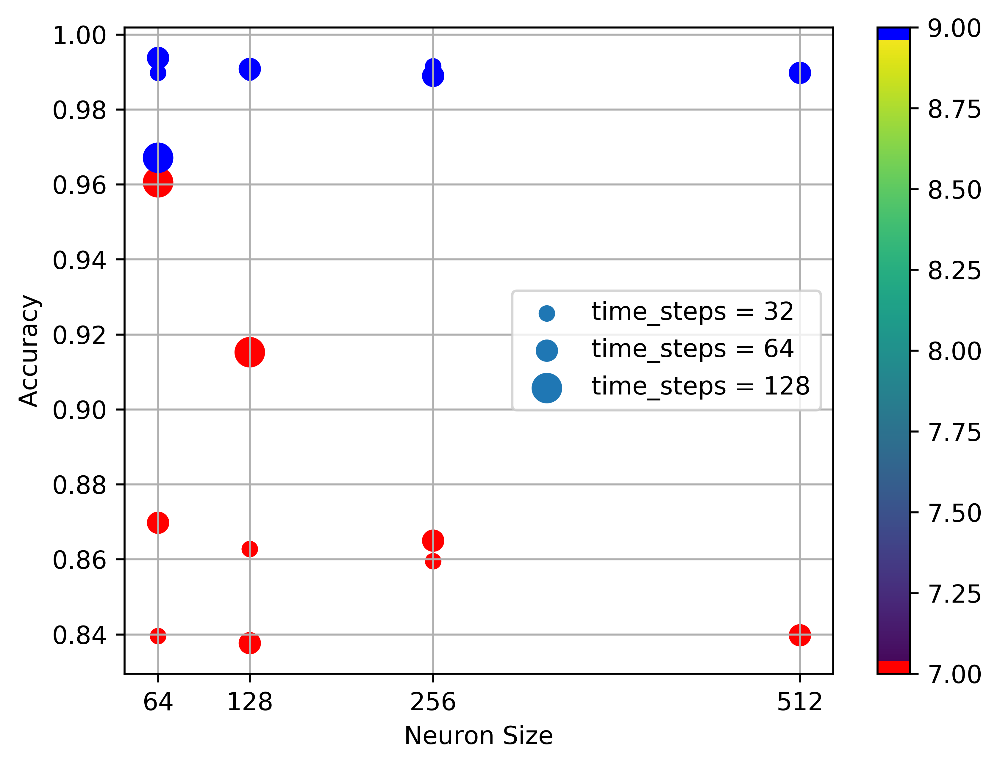

In [71]:
plt.figure(figsize=[6.4, 4.8],dpi=600)
for tstep in [32,64,128]:
    x = acc1[acc1[:,2]==tstep,0]
    y = acc1[acc1[:,2]==tstep,1]
    z = acc1[acc1[:,2]==tstep,3]
    plt.scatter(x,y,s=tstep ,c=z,cmap=newcmp,label='time_steps = '+str(tstep))
    #plt.scatter(acc1[:,0],acc1[:,1],s=acc1[:,2] ,c=acc1[:,3],cmap=newcmp)
plt.colorbar()
plt.xticks(ticks=[64,128,256,512],labels=[64,128,256,512])
plt.xlabel('Neuron Size')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()

In [88]:
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
viridis = cm.get_cmap('viridis', 256)
newcolors = viridis(np.linspace(0, 1, 256))
red = np.array([256/256, 69/256, 0/256, 1])
blue = np.array([0/256, 153/256, 0/256, 1])
newcolors[:5, :] = red
newcolors[251:, :] = blue
newcmp = ListedColormap(newcolors)

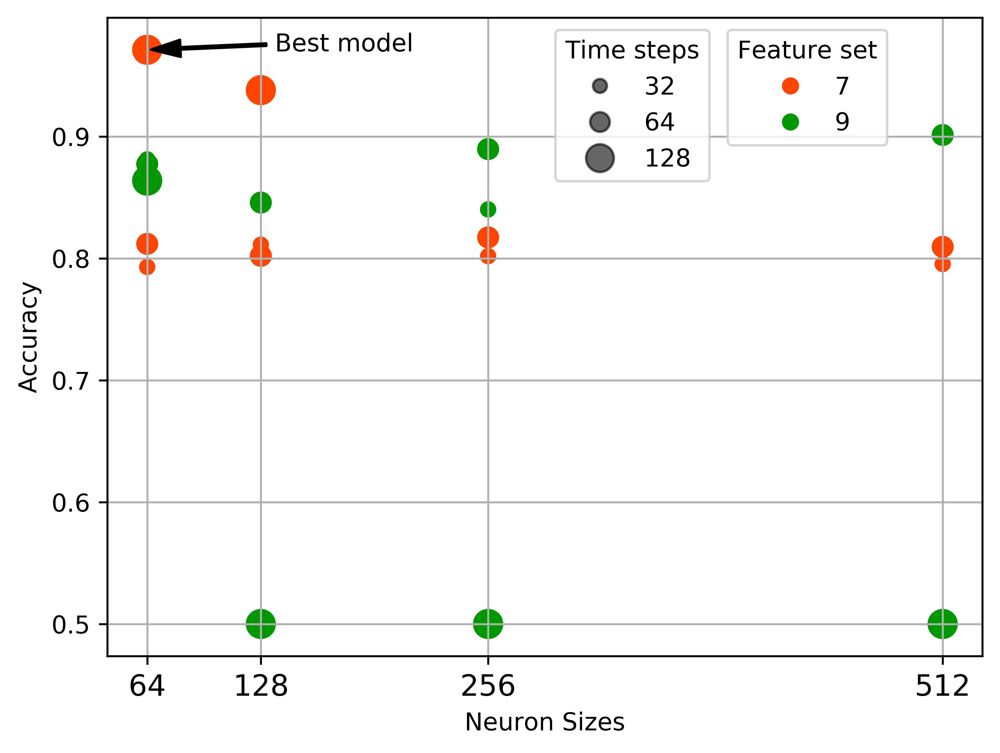

In [108]:
fig, ax = plt.subplots(figsize=[6.4, 4.8],dpi=600)
fig.dpi

scatter = ax.scatter(acc1[:,0],acc1[:,1],s=acc1[:,2] ,c=acc1[:,3],cmap=newcmp)

# produce a legend with the unique colors from the scatter
legend1 = ax.legend(*scatter.legend_elements(),bbox_to_anchor=(.8, 1), loc="upper center", title="Feature set")
ax.add_artist(legend1)

# produce a legend with a cross section of sizes from the scatter
handles, labels = scatter.legend_elements(prop="sizes", alpha=0.6)
legend2 = ax.legend(handles, labels, bbox_to_anchor=(.6, 1), loc="upper center", title="Time steps")

ax.set_xticks([64,128,256,512]) 
ax.set_xticklabels([64,128,256,512], fontsize=12)
ax.set_xlabel('Neuron Sizes')
ax.set_ylabel('Accuracy')
ax.grid()
ax.annotate('Best model', xy=(64, 0.9711), xytext=(136, 0.97),
            arrowprops=dict(facecolor='black', shrink=0.03, width=1, headwidth=7),
            )

plt.show()

In [145]:
pwd = os.getcwd()
all_file_names = []
database_path = pwd[:-6] + "flightData/hardware_data/scenario-1/"
for root, dirs, files in os.walk(database_path):
    all_file_names = [os.path.join(root,file) for file in files]
# print(all_file_names)

In [146]:
time_step = 128
model_path = pwd+'/models/'
model_name = 'lstm_direction_2_layers_1_features_7_neurons_64_timesteps_128_epochs_290.h5'
model = load_model(model_path+model_name)
for i in range(5):
    file = all_file_names[i]
    data = pd.read_csv(file)
    X_test = data.drop(columns=['label', 'time','x','y','pitch_v','roll_v','yaw_v'])
    X_test = X_test.values

    Y_test = data['label'].values
    Y_test = Y_test.reshape((-1,1))

    X_test = scaler7.transform(X_test)
    Y_test = encoder7.transform(Y_test).toarray()

    input_data = X_test[:-time_step,:]
    targets = Y_test[time_step:,:]
    dataset = timeseries_dataset_from_array(input_data, 
                                            targets, 
                                            sequence_length=time_step,
                                            batch_size=128)
    print(file.split('/')[-1])
    hist = model.fit(dataset,
                     epochs=50,
                     verbose=2,
                     callbacks=None,#[batch_print_callback],
                     max_queue_size=512,
                     workers=80,
                     use_multiprocessing=True)
scenario2_acc = []

for file in all_file_names:
    data = pd.read_csv(file)
    X_test = data.drop(columns=['label', 'time','x','y','pitch_v','roll_v','yaw_v'])
    #         print(X_test.describe())
    X_test = X_test.values

    Y_test = data['label'].values
    Y_test = Y_test.reshape((-1,1))

    X_test = scaler7.transform(X_test)
    Y_test = encoder7.transform(Y_test).toarray()

    input_data = X_test[:-time_step,:]
    targets = Y_test[time_step:,:]
    dataset = timeseries_dataset_from_array(input_data, 
                                            targets, 
                                            sequence_length=time_step,
                                            batch_size=128)
    print(file.split('/')[-1])
#     hist = model.fit(dataset,
#                      epochs=10,
#                      verbose=2,
#                      callbacks=None,#[batch_print_callback],
#                      max_queue_size=512,
#                      workers=80,
#                      use_multiprocessing=True)
    hist = model.evaluate(dataset,
                          verbose=1,
                          callbacks=None,#[batch_print_callback],
                          max_queue_size=512,
                          workers=80,
                          use_multiprocessing=True,
                          return_dict=True)
    scenario2_acc.append(hist['categorical_accuracy'])

scenario1_1.csv
Epoch 1/50
52/52 - 3s - loss: 9.1879 - categorical_accuracy: 0.5429
Epoch 2/50
52/52 - 1s - loss: 1.3384 - categorical_accuracy: 0.6702
Epoch 3/50
52/52 - 1s - loss: 0.7919 - categorical_accuracy: 0.7867
Epoch 4/50
52/52 - 1s - loss: 0.2628 - categorical_accuracy: 0.9523
Epoch 5/50
52/52 - 1s - loss: 0.3495 - categorical_accuracy: 0.8908
Epoch 6/50
52/52 - 1s - loss: 0.2548 - categorical_accuracy: 0.9146
Epoch 7/50
52/52 - 1s - loss: 0.2751 - categorical_accuracy: 0.9017
Epoch 8/50
52/52 - 1s - loss: 0.2415 - categorical_accuracy: 0.9163
Epoch 9/50
52/52 - 1s - loss: 0.2416 - categorical_accuracy: 0.9151
Epoch 10/50
52/52 - 1s - loss: 0.2269 - categorical_accuracy: 0.9192
Epoch 11/50
52/52 - 1s - loss: 0.2230 - categorical_accuracy: 0.9200
Epoch 12/50
52/52 - 1s - loss: 0.2149 - categorical_accuracy: 0.9273
Epoch 13/50
52/52 - 1s - loss: 0.2111 - categorical_accuracy: 0.9282
Epoch 14/50
52/52 - 1s - loss: 0.2058 - categorical_accuracy: 0.9311
Epoch 15/50
52/52 - 1s - lo

Epoch 20/50
38/38 - 1s - loss: 0.1483 - categorical_accuracy: 0.9630
Epoch 21/50
38/38 - 1s - loss: 0.1409 - categorical_accuracy: 0.9567
Epoch 22/50
38/38 - 1s - loss: 0.1476 - categorical_accuracy: 0.9630
Epoch 23/50
38/38 - 1s - loss: 0.1407 - categorical_accuracy: 0.9567
Epoch 24/50
38/38 - 1s - loss: 0.1476 - categorical_accuracy: 0.9627
Epoch 25/50
38/38 - 1s - loss: 0.1404 - categorical_accuracy: 0.9567
Epoch 26/50
38/38 - 1s - loss: 0.1478 - categorical_accuracy: 0.9627
Epoch 27/50
38/38 - 1s - loss: 0.1407 - categorical_accuracy: 0.9567
Epoch 28/50
38/38 - 1s - loss: 0.1486 - categorical_accuracy: 0.9561
Epoch 29/50
38/38 - 1s - loss: 0.1409 - categorical_accuracy: 0.9567
Epoch 30/50
38/38 - 1s - loss: 0.1493 - categorical_accuracy: 0.9559
Epoch 31/50
38/38 - 1s - loss: 0.1417 - categorical_accuracy: 0.9567
Epoch 32/50
38/38 - 1s - loss: 0.1499 - categorical_accuracy: 0.9559
Epoch 33/50
38/38 - 1s - loss: 0.1418 - categorical_accuracy: 0.9567
Epoch 34/50
38/38 - 1s - loss: 0.1

Epoch 39/50
39/39 - 1s - loss: 0.0995 - categorical_accuracy: 0.9660
Epoch 40/50
39/39 - 1s - loss: 0.1014 - categorical_accuracy: 0.9668
Epoch 41/50
39/39 - 1s - loss: 0.1117 - categorical_accuracy: 0.9652
Epoch 42/50
39/39 - 1s - loss: 0.1181 - categorical_accuracy: 0.9660
Epoch 43/50
39/39 - 1s - loss: 0.0966 - categorical_accuracy: 0.9664
Epoch 44/50
39/39 - 1s - loss: 0.0910 - categorical_accuracy: 0.9672
Epoch 45/50
39/39 - 1s - loss: 0.0883 - categorical_accuracy: 0.9773
Epoch 46/50
39/39 - 1s - loss: 0.0849 - categorical_accuracy: 0.9775
Epoch 47/50
39/39 - 1s - loss: 0.0861 - categorical_accuracy: 0.9773
Epoch 48/50
39/39 - 1s - loss: 0.0836 - categorical_accuracy: 0.9777
Epoch 49/50
39/39 - 1s - loss: 0.0851 - categorical_accuracy: 0.9773
Epoch 50/50
39/39 - 1s - loss: 0.0829 - categorical_accuracy: 0.9777
scenario1_1.csv
52/52 [==============================] - 1s 25ms/step - loss: 0.3145 - categorical_accuracy: 0.9143
scenario1_10.csv
34/34 [==============================] 

In [160]:
n=len(scenario2_acc)
scenario2_acc = np.array(scenario2_acc)
print(np.mean(scenario2_acc[0:n//2]),np.std(scenario2_acc[0:n//2]))
print(np.mean(scenario2_acc[n//2:]),np.std(scenario2_acc[n//2:]))

0.9563364386558533 0.01128884416956181
0.9464706693376813 0.014943185323698713


In [159]:
scenario2_acc

[0.9406360387802124,
 0.9555049538612366,
 0.9547650218009949,
 0.9774693250656128,
 0.9467455744743347,
 0.953202486038208,
 0.9660316705703735,
 0.9656121134757996,
 0.9525595903396606,
 0.9325581192970276,
 0.961553692817688,
 0.9345294833183289,
 0.9235655069351196,
 0.9549161791801453]